### This script is to resample images : given a set of aerial images for a Ground Sampling Distance D, resample these images to GSD D_target.
#### Example Ground sampling distance : 12.5cm/px and target Ground sampling distance: 15cm/px, 20.0.cm/px and 30.0cm/px.
#### Besides each of the source images for distance D (eg: 12.5cm/px), there are also location annotations with labels. This scripts rescales annotations to target Ground Sampling Distance (eg: 15cm/px, 20cm/px and 30cm/px respectively).
#### Lastly this script validates and displays each image, annotation file pair for compairson between source images with GSD 12.5cm/px with that each of target image, annotation file pair for Ground Sampling distance(15cm/px, 20cm/px and 30cm/px).
#### Validation also involves displaying example cropped images from given annotation location (Bounding box) to compare how the GSD from source differs with that of target GSD (15cm/px, 20cm/px and 30cm/px).

In [1]:
import PIL
print('Pillow Version:', PIL.__version__)
import numpy as np
import os
from pathlib import Path
import re
import json
from PIL import Image, ImageChops, ImageDraw
Image.MAX_IMAGE_PIXELS = None
from IPython.display import display # to display images
from scipy import spatial
from scipy.spatial import distance

import matplotlib.pyplot as plt
%matplotlib inline

Pillow Version: 8.1.0


### Method to create new directory

In [2]:
def create_new_directory(path: Path):
    if os.path.exists(path):
        print("%s Directory already created " % path)
    else:
        try:
            os.mkdir(path)
        except OSError:
            print ("Creation of the directory %s failed" % path)
        else:
            print ("Successfully created the directory %s " % path)
    return True

#### This method plots a given image, annotations pair of files to display the locations for each vehicle category.

In [63]:
def plot_image_annotation_validation(annotationfile: Path, imagefilepath: Path, gsd_value: str):
    
    with open(annotationfile, "r") as json_file:
        data = json.load(json_file)
    assert data, "Invalid annotationsFile "+ str(annotationfile)
    
    foldername = os.path.splitext(os.path.basename(imagefilepath))[0]
    image = Image.open(imagefilepath)
    
    #print(data['locations'])
    #print(np.array([list(inner_dict.values()) for inner_dict in data['locations'].values()]))
    
    for key, values in data['locations'].items():
        #print(key)
        if len(values) != 0:
            #convert them to numpy array for filtering, manipulation.
            l = 1 if len(values) ==1 else 2
            label_locations = np.array([list(v.values()) for v in values][:l])
            
            #print(label_locations[:])
            x = int(label_locations[0,0])
            y = int(label_locations[0,1])
            crop = image.crop((y-200, x-200, y+200,x+200))
            #get only labels that are "in" cropped image
            subset = np.where( (label_locations[:, 0] < (x+200)) & (label_locations[:, 0] > (x-200)) & (label_locations[:, 1] < (y+200)) & (label_locations[:, 1] > (y-200)) )
            #print(subset,label_locations[:, 0][subset]-x+200,label_locations[:, 1][subset]-y+200)
            plt.imshow(np.asarray(crop))
            #plt.plot(640, 570, "og", markersize=10)  # og:shorthand for green circle
            plt.scatter(label_locations[:, 1][subset]-y+200,label_locations[:, 0][subset]-x+200, marker="+", color="red", s=40)
            plt.title("Cropped image from "+ foldername+" " +str(x)+ ","+ str(y)+" with "+ gsd_value+" GSD for class: "+str(key))
            #plt.tight_layout()
            plt.show()
            
            #plt.savefig(foldername+"_class="+str(key)+".jpg")


#### Save the rescaled annotations to a target path

In [3]:
def save_json(jsonstring : dict, filename : str, path :  Path):
    #the main 000X/000X folder
    path = Path(path)
    assert os.path.exists(path), str(path) + " does not exist! Please check the path and try again."
    #filename of annotations 000X_000X_annotations.json
    new_filename = filename.replace("image", "annotations")
    filepath = path.joinpath(new_filename)
    json_filepath = filepath.with_suffix(".json")
    #save annotations json file
    with open(json_filepath, 'w') as fp:
        json.dump(jsonstring, fp)
    #test if file exists
    assert os.path.exists(json_filepath), str(json_filepath) + " does not exists. Please check again."
    print("Rescaled annotations Json file saved successfully @ "+str(json_filepath) )

#### Rescale annotations from source Ground Sampling distance to Target Ground sampling distance which is defined by the scaling factor.

In [4]:
def rescale_annotations(scaling_factor : float, annotationsfile:Path, image : Image,targetsubfolder:Path):
    class_thumbnail_sizes = {'bus': 171,'van_rv':127,'small':101,'specialized':111,'truck':223,'trailer_large': 219,'trailer_small': 101,'unknown':127}
    #retain original thumbnail filename pattern : 12SVK260260_annotated+00000000+class=specialized+x-loc=001725+y-loc=003760
    
    filename = os.path.splitext(os.path.basename(annotationsfile))[0].split("_")[0]+"_annotated+"
    with open(annotationsfile, "r") as json_file:
        data = json.load(json_file)
    assert data, "Invalid annotationsFile "+ str(annotationsfile)
    #print(data['locations'])
    for key, values in data['locations'].items():
        #print(key)
        targetclassfolder = targetsubfolder.joinpath(key)
        create_new_directory(targetclassfolder)
        new_values = list(dict())
        if len(values) != 0:
            for i,value in enumerate(values):
                x= int(value['x']*scaling_factor)
                y= int(value['y']*scaling_factor)
                new_values.append({ "x":float(round(x)), "y":float(round(y))})
                class_size = int(class_thumbnail_sizes[key]/2)
                crop = image.crop(( int(y)-class_size, int(x)-class_size, int(y)+class_size, int(x)+class_size ))
                assert crop.size, "Invalid crop "+str(crop.size)
                
                draw = ImageDraw.Draw(crop)
                draw.line((0, 0) + crop.size, fill=(200,200,200,255))
                draw.line((0, crop.size[1], crop.size[0], 0), fill=(200,200,200,255))
                
                this_filename = filename+str(i).zfill(8)+"+class="+key+"+x-loc="+str(y).zfill(8)+"+y-loc="+str(x).zfill(8)+".JPG"
                filepath = targetclassfolder.joinpath(this_filename)
                crop.convert('RGB').save(filepath)
        data['locations'][key] = new_values
    print("Rescaled annotations successfully!")
    return data

#### Save the plot images that compare between two different GSD images.

In [5]:
def plot_save_image(oldimage : Image, newimage : Image, targetfolder : Path, gsd_dict : dict):
    fig = plt.figure()
    ax1 = fig.add_subplot(2,2,1)
    ax2 = fig.add_subplot(2,2,2)
    ax1.set_title('Image with '+str(gsd_dict['input_gsd'])+' GSD '+str(oldimage.size), fontsize=8)
    ax1.imshow(np.asarray(oldimage))
    ax2.set_title('Image with '+str(gsd_dict['output_gsd'])+' GSD '+str(newimage.size), fontsize=8)
    ax2.imshow(np.asarray(newimage))
    plt.tight_layout()
    plt.show()
    plt.savefig(targetfolder.joinpath('compare_images.jpg'))


#### Firslty resample a given image of Ground Sampling distance to target Ground sampling distance) which is of format example: {'input_gsd': 12.5, 'output_gsd':15}. And once image has been resampled, 
#### this method rescales annotations to target Ground Sampling distance. Concludes by plotting the the two main images of two different GSD (Source and target GSD).

In [6]:
def resample_image(imfilepath : Path, targetfolder : Path, annotationfilepath : Path, gsd : dict(),targetsubfolder:Path):
    
    #calculate scaling factor
    scaling_factor = gsd['input_gsd']/gsd['output_gsd']
    print("Scaling factor is "+str(scaling_factor))
    
    im = Image.open(imfilepath)
    assert im, "Invalid Image"
    assert scaling_factor, "Empty scaling factor"
    W,H = im.size #original image size (W,H)
    print("Width and height before scaling: ", W,H)
    ar = W/H #original aspect ratio
    W_new, H_new = [ int(round(W * scaling_factor)),int(round(H* scaling_factor)) ]
    print("Target width, height to be rescaled: ",W_new, H_new)
    
    #resize, resample LANCZOS
    newimage = im.resize((W_new, H_new), resample=PIL.Image.LANCZOS, box=None)
    assert newimage, "Error while resampling with "+str(W_new)+" and "+str(H_new)+" for LANCZOS method"
    print("Rescaled to GSD "+str(gsd['output_gsd'])+" Image size: "+str(newimage.size))
    
    w_new, h_new = newimage.size
    diff_aspect_ratio = (ar) - (w_new/h_new)
    print("approx. difference in aspect ratio of oldimage and newimage: ", diff_aspect_ratio)
    diff_width = W_new - w_new
    diff_height = H_new - h_new
    print("approx. difference in expected width,height and rescaled width, height: ",diff_width, diff_height )

    imgfilename = targetfolder.joinpath(os.path.basename(imfilepath))
    newimage.save(str(imgfilename))
    
    data = rescale_annotations(scaling_factor, annotationfilepath, newimage,targetsubfolder)
    #save annotations
    save_json(data, os.path.basename(annotationfilepath), targetfolder )
    
    #plot thw two images with respective sizes
    plot_save_image(im,newimage, targetfolder, gsd)
    return newimage

#### Since we have bunch of images with varying formats, it is assumed for a given source Ground sampling distance, we would have a series of Large images.
#### Thus a given directory contains multiple folders each containing a one large image of format .png and corresponding imagename_annotations.json respectively.
#### This method "walks through" OS directory to extract each of folder's image, annotation file pairs and conducts resampling sequentially,
#### by calling resample_image, rescale_annotations and plot_save_image and save_json methods.
#### Thus points to note are: source folder contains several subfolders for each corresponding large image with its own annotation JSON file respectively.
#### Target directory in this case is the name of target GSD which will be parent direcory of source folder. 
#### You can provide and modify these methods as required in this method. 
#### This method assumes target folder to be created under parent of Source folder for conventionality.

In [66]:
def start_resampling(gsd : dict, sourcefolderpath : str, targetfoldername : str):
    
    path = Path(os.getcwd())
    #get new folder's storage entry folder, there on, folders likely similar ?
    filedir = path.joinpath(path.parent, sourcefolderpath)
                           #"0001","0001","01 Final Annotation Galleries"
        
    #create target directory under parent directory of Source folder i.e. sourcefolderpath
    targetroot = filedir.parent.joinpath(targetfoldername)
    create_new_directory(targetroot)

    main_folders = [filedir.joinpath(name) for name in os.listdir(filedir)] 
    results = dict()
    annotations_count = 0
    for f in main_folders:
        print("folder", f)
        this_key = None
        for root, dirs, files in os.walk(f):
            #ignore ipynb_checkpoints folders
            if re.search(".ipynb_checkpoints",os.path.basename(Path(root))) or \
            re.search("Final Annotation Galleries",str(Path(root))):
                continue
            if len(dirs) != 0:
                #check if Annotation galleries exist
                galleries = [ dirs.remove(d) for d in dirs if re.search("Final Annotation Galleries",str(d)) or ".ipynb_checkpoints" in d]
                #check if main image file exists 000X_000X_image.png exists ?
                image_files = [ file for file in files if re.search("[A-Za-z0-9]*.png",file)]
                annotation_file = [ file for file in files if re.search("[A-Za-z0-9]*(_)annotations.json",file)]

            #valid folders and files exists ?
            if len(image_files) > 0 :
                #prepare results dict serializable for Json format.
                results = dict()
                this_key = root
                results["file"] = image_files[0]
                results["locations"] = dict()
                imfilepath = Path(root, image_files[0])
                annotationfilepath = Path(root, annotation_file[0])
                print(root)
                
                #create main folder 000X that contains subfolders of 000Y- which contains main image.
                targetmainfolder = targetroot.joinpath(os.path.basename(Path(f)))
                create_new_directory(targetmainfolder)
                
                #create actual main image subfolder i.e. 000Y
                #targetfolder = targetmainfolder.joinpath(os.path.basename(Path(root)))
                #create_new_directory(targetfolder)
                
                #create annotation gallery
                targetsubfolder = targetmainfolder.joinpath("Final Annotation Galleries")
                create_new_directory(targetsubfolder)

                #rescale the image
                newimage = resample_image(imfilepath, targetmainfolder, annotationfilepath, gsd,targetsubfolder)
                #check of rescaled image exists
                assert newimage, "Invalid resampling "

#### You ***MUST*** change the path of root, source folder name and target folder name respectively.
#### It is recommended that target folder name be target Ground sampling distance.
#### GSD dictionary example: {'input_gsd': 12.5, 'output_gsd':15}
#### NOTE***: Since start_resampling method assumes target folder to be created under parent of Source folder for conventionality, you
#### might want to edit or modify that in start_resampling method.

C:\Users\exx\Documents\lab\AGRC(Utah)\15cm Directory already created 
folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK260260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK260260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK260260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK260260\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK260260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK260260\Final Annotation Galleries\small 
Succ

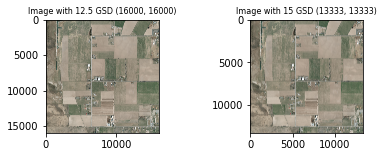

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280260\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280260\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

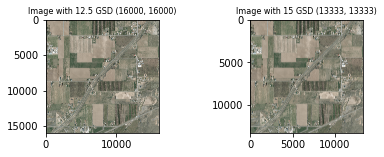

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280280
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280280
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280280 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280280\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280280\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK280280\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

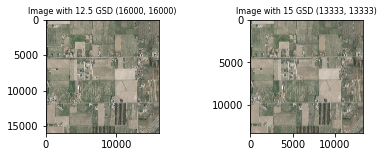

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK300260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK300260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK300260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK300260\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK300260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK300260\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

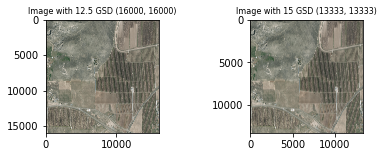

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100560
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100560
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100560 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100560\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100560\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100560\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

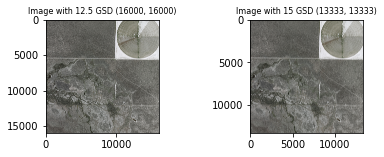

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100580
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100580
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100580 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100580\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100580\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100580\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

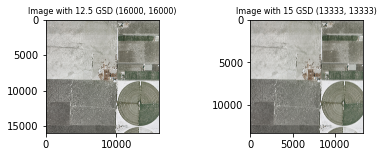

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100600
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100600
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100600 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100600\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100600\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100600\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

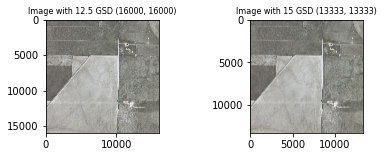

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100620
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100620
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100620 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100620\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100620\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK100620\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

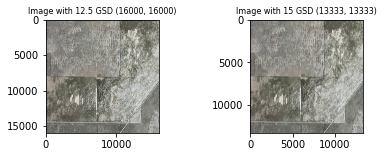

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220740\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

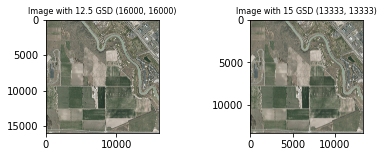

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220760\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK220760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

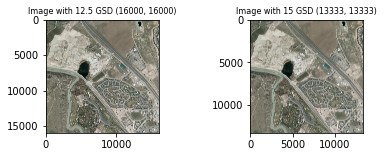

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240740\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

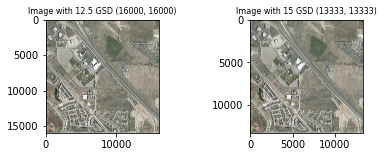

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240760\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK240760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

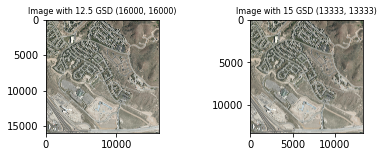

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320300
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320300
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320300 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320300\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320300\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320300\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

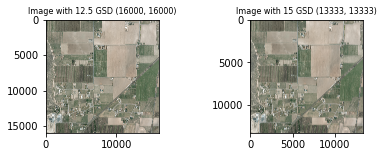

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320320
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320320
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320320 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320320\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320320\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320320\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

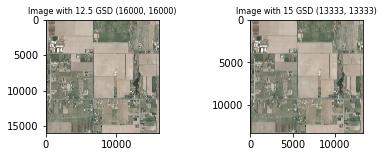

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320340
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320340
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320340 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320340\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320340\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320340\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

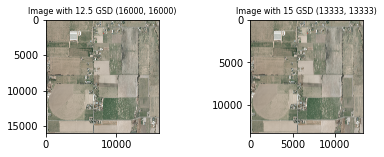

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320360\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

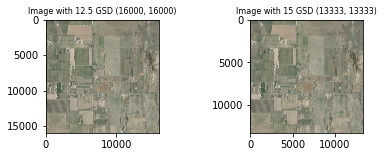

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340320
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340320
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340320 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340320\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340320\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340320\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

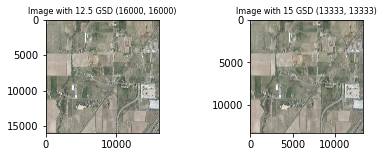

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340340
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340340
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340340 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340340\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340340\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340340\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

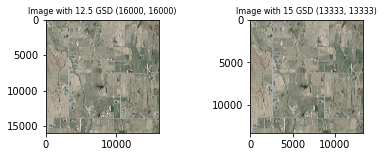

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340360\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

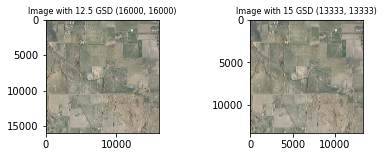

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340420
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340420
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340420 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340420\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340420\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK340420\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

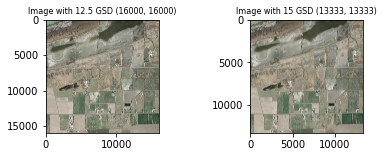

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360360\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

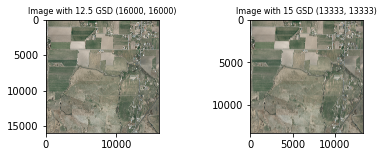

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360380
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360380
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360380 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360380\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360380\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360380\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

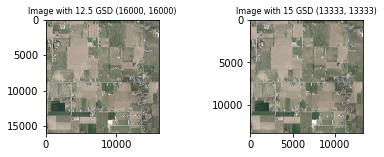

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360400
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360400
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360400 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360400\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360400\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360400\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

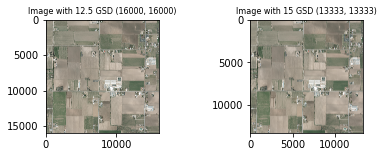

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360420
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360420
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360420 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360420\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360420\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK360420\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

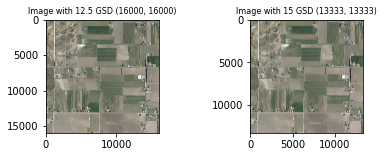

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060720
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060720
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060720 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060720\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060720\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060720\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

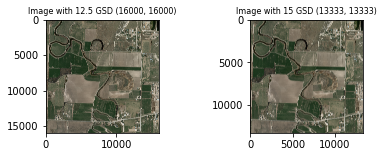

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060740\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL060740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

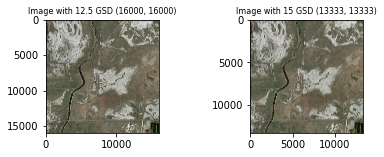

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL080740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL080740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL080740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL080740\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL080740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL080740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

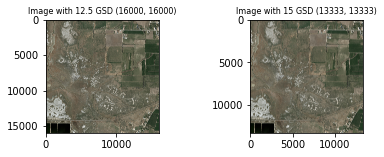

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL100740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL100740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL100740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL100740\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL100740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL100740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

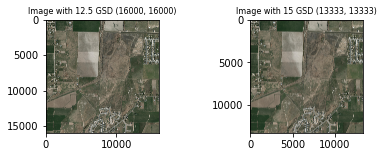

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120740\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

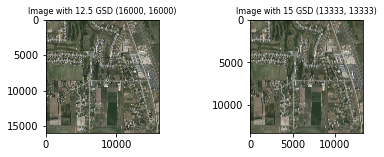

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120760\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

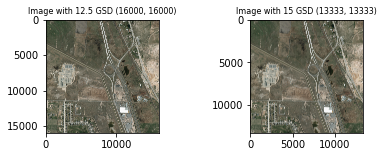

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120780
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120780
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120780 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120780\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120780\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120780\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

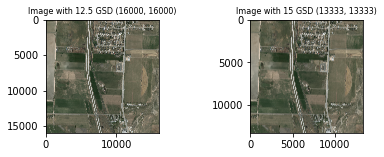

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL240800
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL240800
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL240800 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL240800\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL240800\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL240800\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

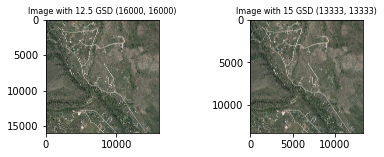

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260780
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260780
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260780 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260780\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260780\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260780\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

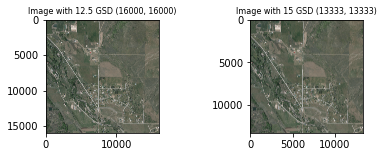

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260800
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260800
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260800 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260800\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260800\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL260800\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

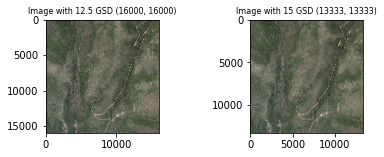

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL280760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL280760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL280760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL280760\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL280760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL280760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

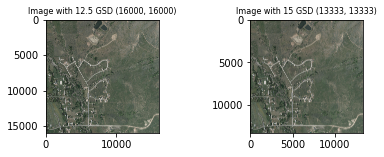

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360660
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360660
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360660 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360660\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360660\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360660\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

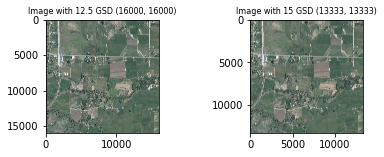

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360680
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360680
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360680 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360680\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360680\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360680\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

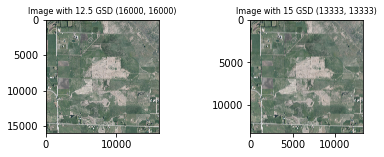

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360700
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360700
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360700 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360700\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360700\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL360700\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

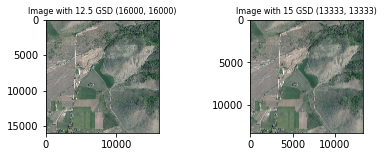

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380640
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380640
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380640 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380640\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380640\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380640\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

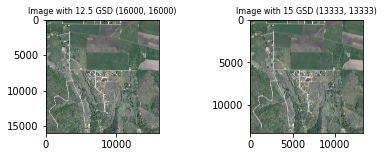

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380660
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380660
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380660 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380660\Final Annotation Galleries 
Scaling factor is 0.8333333333333334
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  13333 13333
Rescaled to GSD 15 Image size: (13333, 13333)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380660\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL380660\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\1

<Figure size 432x288 with 0 Axes>

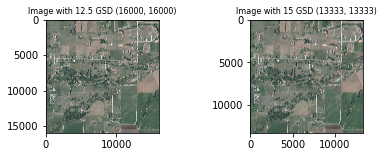

<Figure size 432x288 with 0 Axes>

In [8]:
#downsample from 12.5xm/px to 15cm/px
root = os.path.join(r'C:\Users\exx\Documents\lab\AGRC(Utah)')
sourcefolderpath = os.path.join(root,'01 HRO 2012 (12.5cm)')
targetfoldername = os.path.join(root,"15cm")
gsd_dict = {'input_gsd': 12.5, 'output_gsd':15}
start_resampling(gsd_dict, sourcefolderpath, targetfoldername )

C:\Users\exx\Documents\lab\AGRC(Utah)\20cm Directory already created 
folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK260260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK260260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK260260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK260260\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK260260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK260260\Final Annotation Galleries\small 
Successfully crea

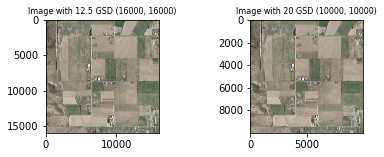

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280260\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280260\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK2802

<Figure size 432x288 with 0 Axes>

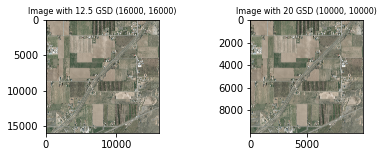

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280280
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280280
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280280 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280280\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280280\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK280280\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK2802

<Figure size 432x288 with 0 Axes>

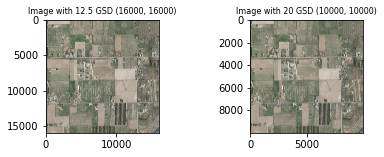

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK300260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK300260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK300260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK300260\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK300260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK300260\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12SVK3002

<Figure size 432x288 with 0 Axes>

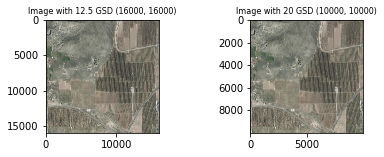

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100560
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100560
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100560 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100560\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100560\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100560\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK1005

<Figure size 432x288 with 0 Axes>

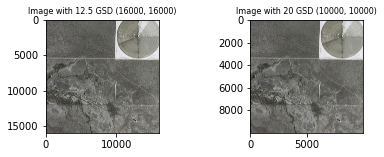

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100580
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100580
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100580 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100580\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100580\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100580\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK1005

<Figure size 432x288 with 0 Axes>

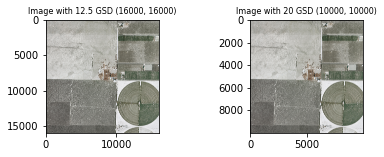

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100600
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100600
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100600 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100600\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100600\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100600\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK1006

<Figure size 432x288 with 0 Axes>

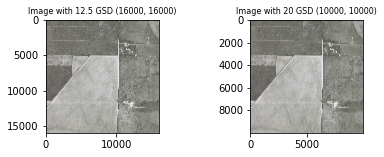

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100620
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100620
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100620 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100620\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100620\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK100620\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK1006

<Figure size 432x288 with 0 Axes>

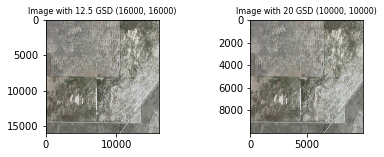

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220740\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK2207

<Figure size 432x288 with 0 Axes>

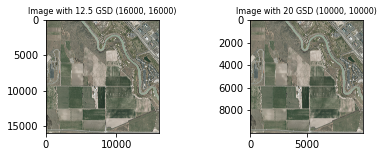

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220760\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK220760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK2207

<Figure size 432x288 with 0 Axes>

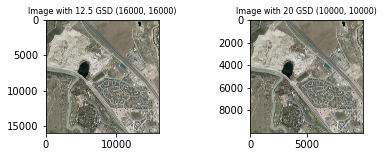

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240740\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK2407

<Figure size 432x288 with 0 Axes>

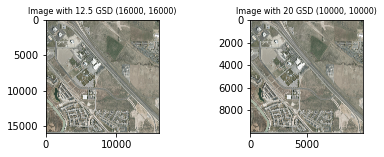

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240760\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK240760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK2407

<Figure size 432x288 with 0 Axes>

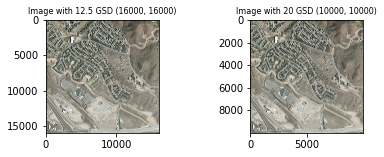

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320300
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320300
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320300 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320300\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320300\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320300\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3203

<Figure size 432x288 with 0 Axes>

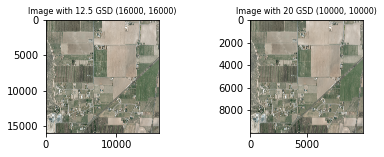

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320320
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320320
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320320 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320320\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320320\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320320\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3203

<Figure size 432x288 with 0 Axes>

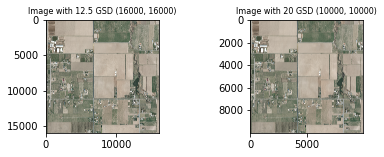

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320340
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320340
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320340 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320340\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320340\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320340\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3203

<Figure size 432x288 with 0 Axes>

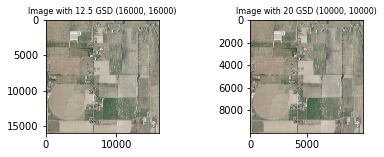

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320360\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK320360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3203

<Figure size 432x288 with 0 Axes>

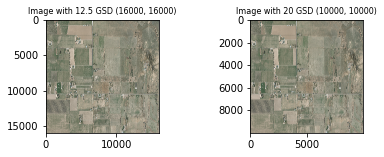

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340320
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340320
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340320 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340320\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340320\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340320\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3403

<Figure size 432x288 with 0 Axes>

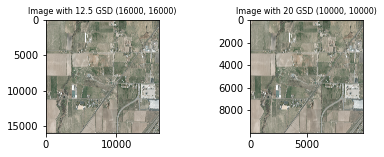

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340340
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340340
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340340 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340340\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340340\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340340\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3403

<Figure size 432x288 with 0 Axes>

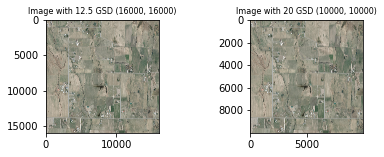

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340360\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3403

<Figure size 432x288 with 0 Axes>

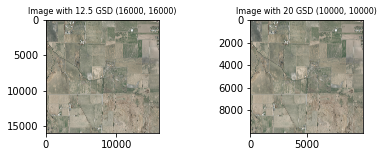

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340420
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340420
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340420 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340420\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340420\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK340420\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3404

<Figure size 432x288 with 0 Axes>

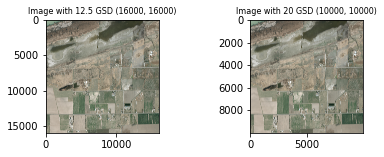

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360360\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3603

<Figure size 432x288 with 0 Axes>

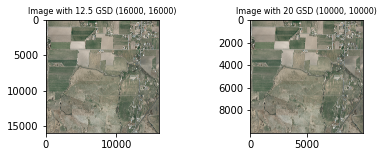

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360380
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360380
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360380 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360380\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360380\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360380\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3603

<Figure size 432x288 with 0 Axes>

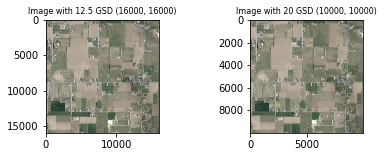

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360400
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360400
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360400 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360400\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360400\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360400\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3604

<Figure size 432x288 with 0 Axes>

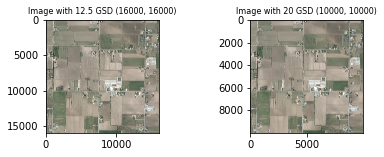

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360420
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360420
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360420 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360420\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360420\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK360420\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVK3604

<Figure size 432x288 with 0 Axes>

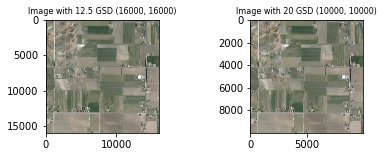

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060720
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060720
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060720 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060720\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060720\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060720\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL0607

<Figure size 432x288 with 0 Axes>

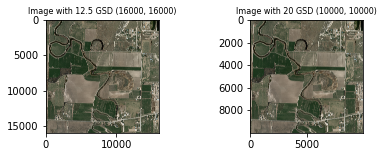

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060740\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL060740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL0607

<Figure size 432x288 with 0 Axes>

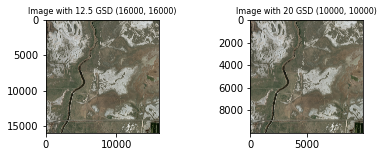

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL080740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL080740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL080740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL080740\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL080740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL080740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL0807

<Figure size 432x288 with 0 Axes>

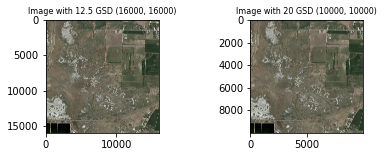

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL100740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL100740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL100740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL100740\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL100740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL100740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL1007

<Figure size 432x288 with 0 Axes>

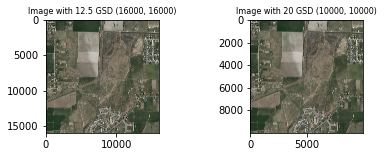

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120740\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL1207

<Figure size 432x288 with 0 Axes>

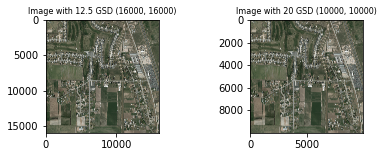

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120760\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL1207

<Figure size 432x288 with 0 Axes>

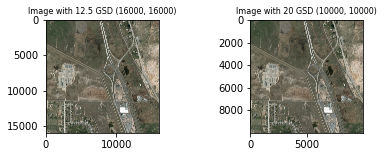

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120780
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120780
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120780 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120780\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120780\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL120780\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL1207

<Figure size 432x288 with 0 Axes>

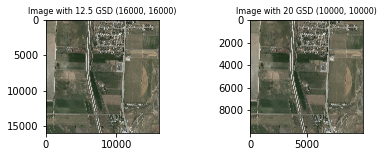

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL240800
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL240800
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL240800 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL240800\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL240800\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL240800\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL2408

<Figure size 432x288 with 0 Axes>

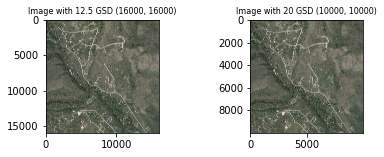

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260780
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260780
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260780 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260780\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260780\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260780\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL2607

<Figure size 432x288 with 0 Axes>

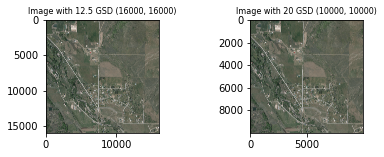

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260800
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260800
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260800 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260800\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260800\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL260800\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL2608

<Figure size 432x288 with 0 Axes>

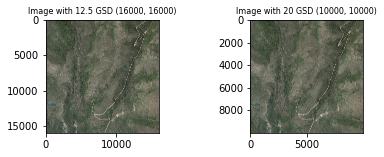

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL280760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL280760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL280760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL280760\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL280760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL280760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL2807

<Figure size 432x288 with 0 Axes>

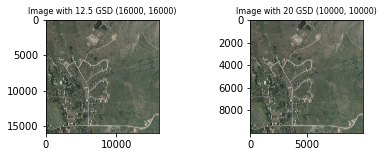

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360660
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360660
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360660 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360660\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360660\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360660\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL3606

<Figure size 432x288 with 0 Axes>

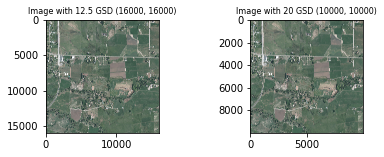

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360680
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360680
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360680 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360680\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360680\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360680\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL3606

<Figure size 432x288 with 0 Axes>

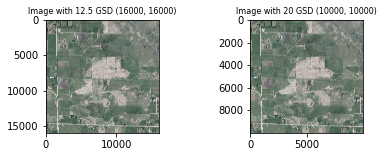

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360700
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360700
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360700 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360700\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360700\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL360700\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL3607

<Figure size 432x288 with 0 Axes>

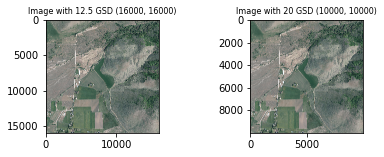

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380640
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380640
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380640 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380640\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380640\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380640\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL3806

<Figure size 432x288 with 0 Axes>

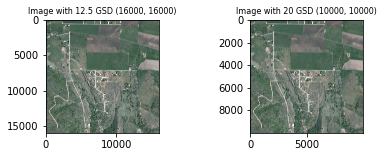

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380660
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380660
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380660 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380660\Final Annotation Galleries 
Scaling factor is 0.625
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  10000 10000
Rescaled to GSD 20 Image size: (10000, 10000)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380660\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL380660\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\20cm\12TVL3806

<Figure size 432x288 with 0 Axes>

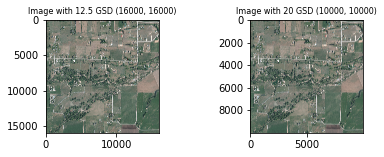

<Figure size 432x288 with 0 Axes>

In [9]:
#downsample from 12.5xm/px to 20cm/px
root = os.path.join(r'C:\Users\exx\Documents\lab\AGRC(Utah)')
sourcefolderpath = os.path.join(root,'01 HRO 2012 (12.5cm)')
targetfoldername = os.path.join(root,"20cm")
gsd_dict = {'input_gsd': 12.5, 'output_gsd':20}
start_resampling(gsd_dict, sourcefolderpath, targetfoldername )

C:\Users\exx\Documents\lab\AGRC(Utah)\30cm Directory already created 
folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK260260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK260260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK260260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK260260\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK260260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK260260\Final Annotation Galleries\small 
Successf

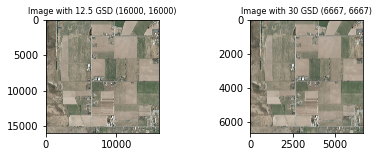

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280260\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280260\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

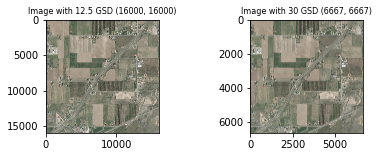

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280280
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK280280
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280280 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280280\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280280\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK280280\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

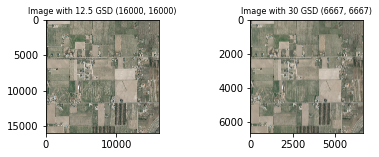

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK300260
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK300260
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK300260 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK300260\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK300260\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12SVK300260\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

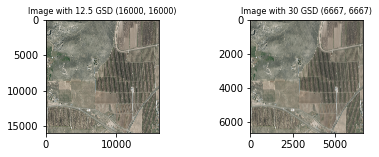

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100560
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100560
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100560 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100560\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100560\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100560\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

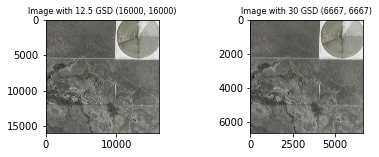

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100580
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100580
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100580 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100580\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100580\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100580\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

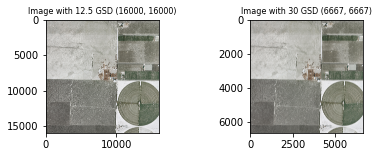

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100600
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100600
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100600 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100600\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100600\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100600\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

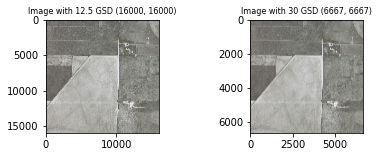

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100620
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK100620
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100620 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100620\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100620\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK100620\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

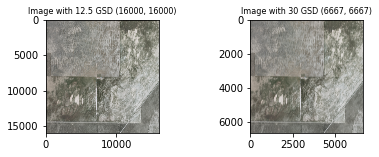

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220740\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

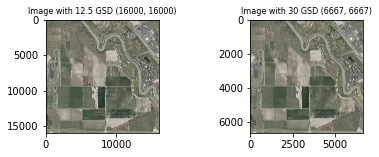

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK220760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220760\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK220760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

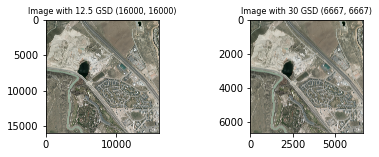

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240740\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

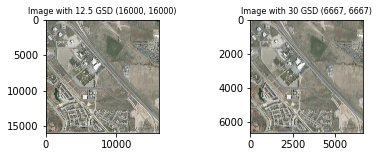

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK240760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240760\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK240760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

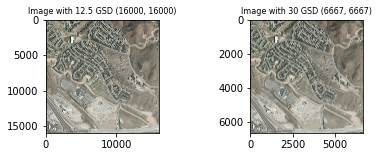

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320300
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320300
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320300 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320300\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320300\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320300\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

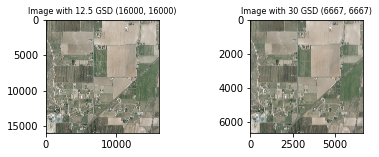

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320320
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320320
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320320 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320320\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320320\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320320\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

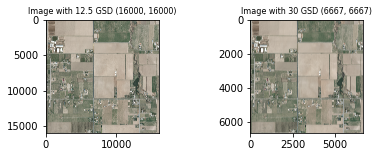

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320340
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320340
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320340 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320340\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320340\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320340\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

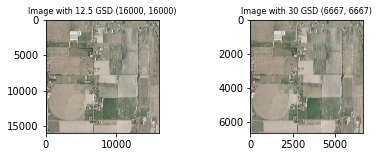

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320360\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK320360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

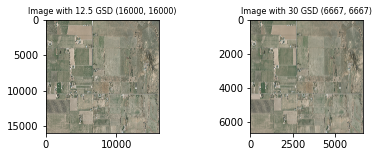

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340320
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340320
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340320 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340320\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340320\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340320\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

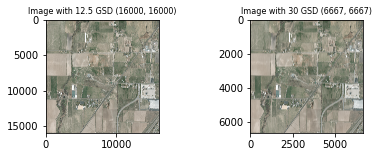

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340340
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340340
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340340 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340340\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340340\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340340\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

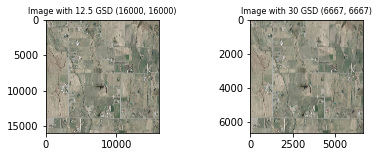

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340360\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

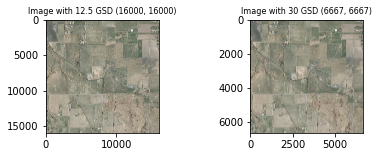

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340420
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK340420
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340420 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340420\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340420\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK340420\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

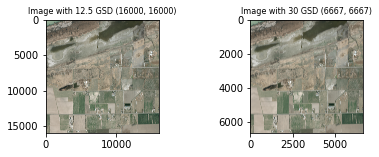

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360360
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360360
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360360 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360360\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360360\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360360\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

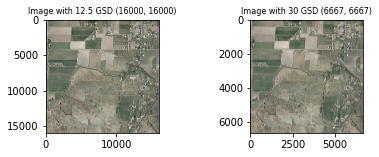

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360380
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360380
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360380 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360380\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360380\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360380\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

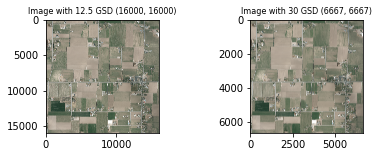

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360400
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360400
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360400 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360400\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360400\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360400\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

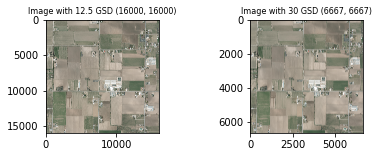

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360420
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK360420
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360420 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360420\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360420\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVK360420\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

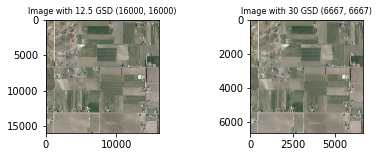

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060720
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060720
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060720 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060720\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060720\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060720\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

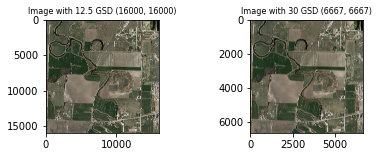

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL060740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060740\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL060740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

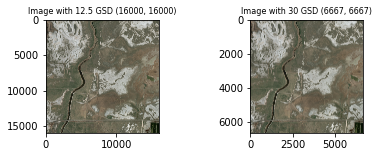

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL080740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL080740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL080740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL080740\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL080740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL080740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

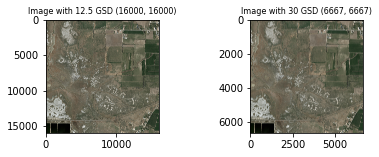

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL100740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL100740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL100740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL100740\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL100740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL100740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

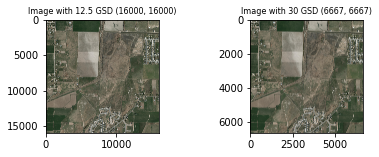

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120740
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120740
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120740 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120740\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120740\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120740\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

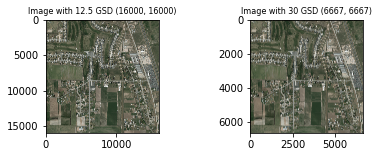

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120760\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

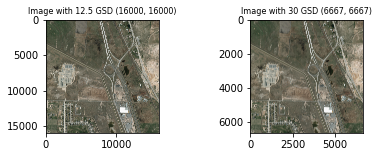

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120780
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120780
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120780 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120780\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120780\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL120780\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

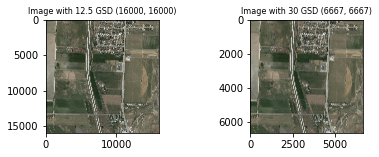

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL240800
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL240800
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL240800 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL240800\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL240800\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL240800\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

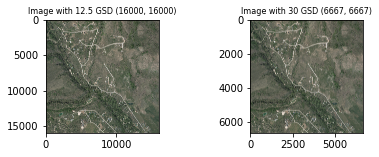

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260780
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260780
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260780 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260780\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260780\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260780\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

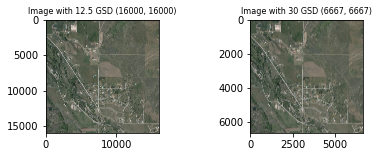

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260800
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL260800
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260800 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260800\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260800\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL260800\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

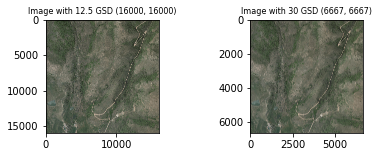

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL280760
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL280760
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL280760 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL280760\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL280760\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL280760\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

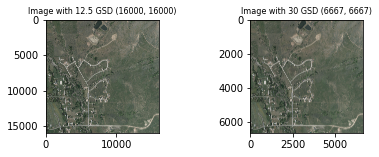

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360660
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360660
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360660 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360660\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360660\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360660\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

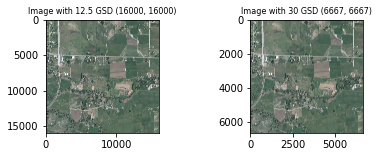

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360680
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360680
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360680 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360680\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360680\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360680\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

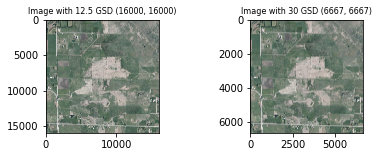

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360700
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL360700
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360700 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360700\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360700\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL360700\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

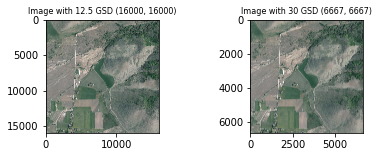

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380640
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380640
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380640 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380640\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380640\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380640\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

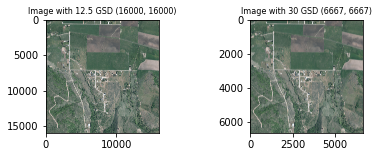

folder C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380660
C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL380660
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380660 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380660\Final Annotation Galleries 
Scaling factor is 0.4166666666666667
Width and height before scaling:  16000 16000
Target width, height to be rescaled:  6667 6667
Rescaled to GSD 30 Image size: (6667, 6667)
approx. difference in aspect ratio of oldimage and newimage:  0.0
approx. difference in expected width,height and rescaled width, height:  0 0
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380660\Final Annotation Galleries\bus 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\12TVL380660\Final Annotation Galleries\small 
Successfully created the directory C:\Users\exx\Documents\lab\AGRC(Utah)\30cm\

<Figure size 432x288 with 0 Axes>

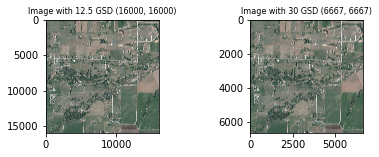

<Figure size 432x288 with 0 Axes>

In [10]:
#downsample from 12.5xm/px to 30cm/px
root = os.path.join(r'C:\Users\exx\Documents\lab\AGRC(Utah)')
sourcefolderpath = os.path.join(root,'01 HRO 2012 (12.5cm)')
targetfoldername = os.path.join(root,"30cm")
gsd_dict = {'input_gsd': 12.5, 'output_gsd':30}
start_resampling(gsd_dict, sourcefolderpath, targetfoldername )

In [11]:
def plot_save_2images(oldimage : Image, newimage : Image, targetfolder : Path):
    fig = plt.figure()
    ax1 = fig.add_subplot(2,2,1)
    ax2 = fig.add_subplot(2,2,2)
    ax1.set_title('Image 1 '+str(oldimage.size), fontsize=8)
    ax1.imshow(np.asarray(oldimage))
    ax2.set_title('Image 2 '+str(newimage.size), fontsize=8)
    ax2.imshow(np.asarray(newimage))
    plt.tight_layout()
    plt.show()
    plt.savefig(targetfolder.joinpath('plot2images.jpg'))

In [12]:
def compare_image_files(image1path:Path, image2path:Path):
    origimage = Image.open(image1path)
    resimage = Image.open(image2path)
    assert origimage.size != resimage.size, "Original and resampled image sizes are equal"
    cwdpath =  Path(os.getcwd()).parent
    plot_save_2images(origimage, resimage, cwdpath)
    return True

In [13]:
def compare_annotation_files(orig_annotation_file : Path, resampled_annotation_file: Path):
    with open(orig_annotation_file, "r") as json_file:
        origdata = json.load(json_file)
    assert origdata, "Invalid annotationsFile "+ str(orig_annotation_file)
    with open(resampled_annotation_file, "r") as json_file:
        resampleddata = json.load(json_file)
    assert resampleddata, "Invalid annotationsFile "+ str(resampled_annotation_file)

    orig_data_items = origdata['locations'].items()
    res_data_items = resampleddata['locations'].items()
    
    result = (len(orig_data_items) == len(res_data_items))
    assert result == True, "Two annotation files values are not equal"
    return True

In [17]:
#compare two given folders (source, resampled) and 
#validate annotations and images "Storage/LINZ/Final/Temp_0.150m_per_px/0001/0007" 
#with "Storage/LINZ/Final/_Temp_0.150m_per_px/0001/0007"
def compare_validate_original_resampled(originalfolder : str, resampledfolder : str):
    #check if main image file exists 0001_0007_image.png and annotations file exists ?
    #cwdpath = Path(os.getcwd())

    #first in original source folder
    orig_files = os.listdir(originalfolder)
    orig_image_files = [ file for file in orig_files if re.search("[A-Za-z0-9]*.png",file)]
    orig_annotation_files = [ file for file in orig_files if re.search("[A-Za-z0-9]*(_)annotations.json",file)]
    
    # and in resampled folder
    resampled_files = os.listdir(os.path.join(resampledfolder))
    res_image_files = [ file for file in resampled_files if re.search("[A-Za-z0-9]*.png",file)]
    res_annotation_files = [ file for file in resampled_files if re.search("[A-Za-z0-9]*(_)annotations.json",file)]
    result = compare_image_files(os.path.join(originalfolder, orig_image_files[0]),
                       os.path.join(resampledfolder, res_image_files[0]))
    assert result, "Images are not equal!"
    
    result = compare_annotation_files(os.path.join(originalfolder, orig_annotation_files[0]),
                             os.path.join(resampledfolder, res_annotation_files[0]))
    assert result, "Annotation files are not equal!"
    return True

C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12SVK260260 C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12SVK260260


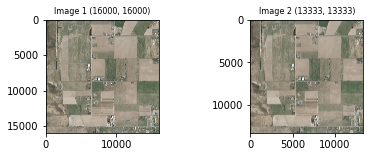

C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVK320320 C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVK320320


<Figure size 432x288 with 0 Axes>

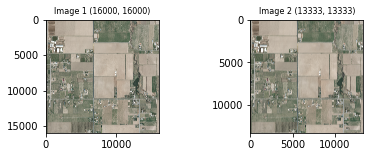

C:\Users\exx\Documents\lab\AGRC(Utah)\01 HRO 2012 (12.5cm)\12TVL120760 C:\Users\exx\Documents\lab\AGRC(Utah)\15cm\12TVL120760


<Figure size 432x288 with 0 Axes>

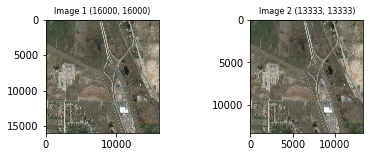

<Figure size 432x288 with 0 Axes>

In [18]:
#for self-learning, validate downsampled from 12.5cm/px to 15cm/px and original source 15cm/px image
root = os.path.join(r'C:\Users\exx\Documents\lab\AGRC(Utah)')
sources = [os.path.join(root,"01 HRO 2012 (12.5cm)","12SVK260260"), 
os.path.join(root,"01 HRO 2012 (12.5cm)","12TVK320320"),os.path.join(root, "01 HRO 2012 (12.5cm)","12TVL120760")]
resampledsources = [os.path.join(root,"15cm","12SVK260260"), 
os.path.join(root,"15cm","12TVK320320"), os.path.join(root,"15cm","12TVL120760")]

for origsource, resampledsource in zip(sources, resampledsources):
    print(origsource, resampledsource )
    result = compare_validate_original_resampled(origsource, resampledsource)
    assert result, "Not equal or same!"

In [63]:
def plot_image_annotation_validation(annotationfile: Path, imagefilepath: Path, gsd_value: str):
    
    with open(annotationfile, "r") as json_file:
        data = json.load(json_file)
    assert data, "Invalid annotationsFile "+ str(annotationfile)
    
    foldername = os.path.splitext(os.path.basename(imagefilepath))[0]
    image = Image.open(imagefilepath)
    
    #print(data['locations'])
    #print(np.array([list(inner_dict.values()) for inner_dict in data['locations'].values()]))
    
    for key, values in data['locations'].items():
        #print(key)
        if len(values) != 0:
            #convert them to numpy array for filtering, manipulation.
            l = 1 if len(values) ==1 else 2
            label_locations = np.array([list(v.values()) for v in values][:l])
            
            #print(label_locations[:])
            x = int(label_locations[0,0])
            y = int(label_locations[0,1])
            crop = image.crop((y-200, x-200, y+200,x+200))
            #get only labels that are "in" cropped image
            subset = np.where( (label_locations[:, 0] < (x+200)) & (label_locations[:, 0] > (x-200)) & (label_locations[:, 1] < (y+200)) & (label_locations[:, 1] > (y-200)) )
            #print(subset,label_locations[:, 0][subset]-x+200,label_locations[:, 1][subset]-y+200)
            plt.imshow(np.asarray(crop))
            #plt.plot(640, 570, "og", markersize=10)  # og:shorthand for green circle
            plt.scatter(label_locations[:, 1][subset]-y+200,label_locations[:, 0][subset]-x+200, marker="+", color="red", s=40)
            plt.title("Cropped image from "+ foldername+" " +str(x)+ ","+ str(y)+" with "+ gsd_value+" GSD for class: "+str(key))
            #plt.tight_layout()
            plt.show()
            
            #plt.savefig(foldername+"_class="+str(key)+".jpg")


********************************Source Image : 12.5cm/px, cropped images with Annotations******************************************


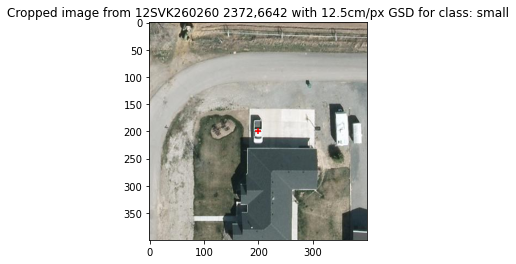

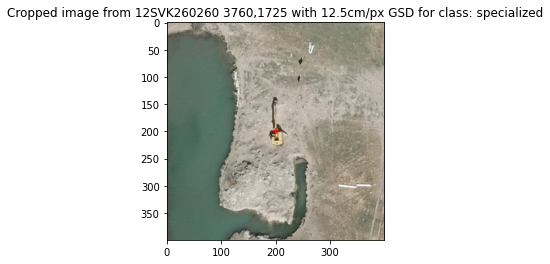

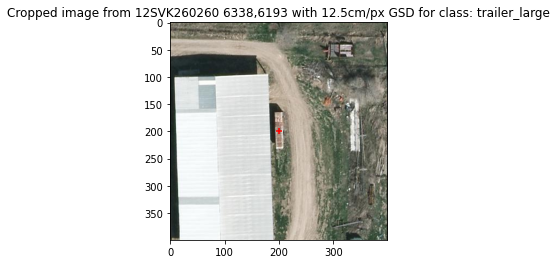

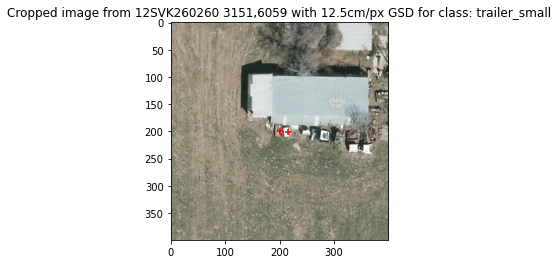

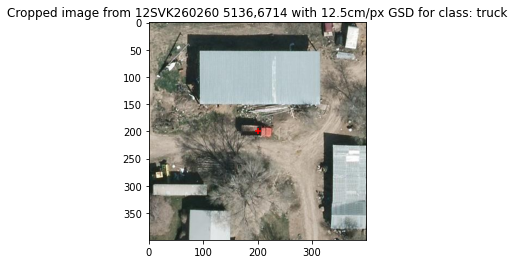

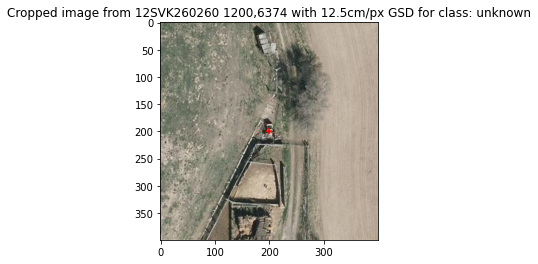

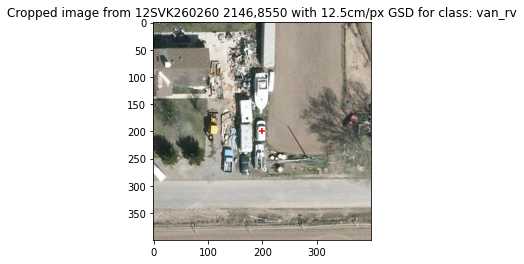

********************************Target Image : 15.0cm/px, cropped images with Annotations******************************************


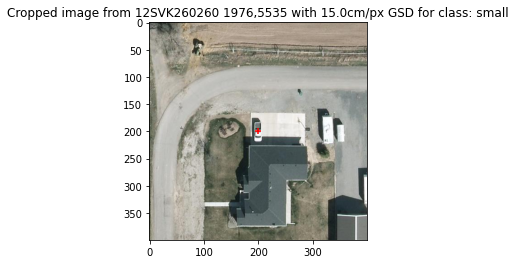

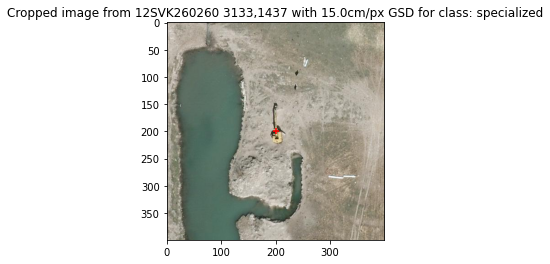

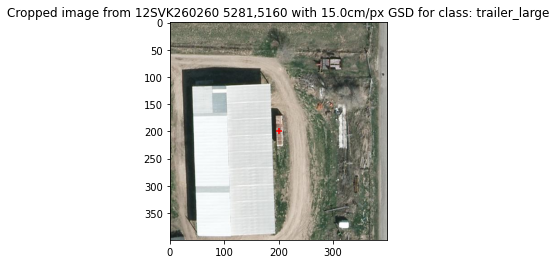

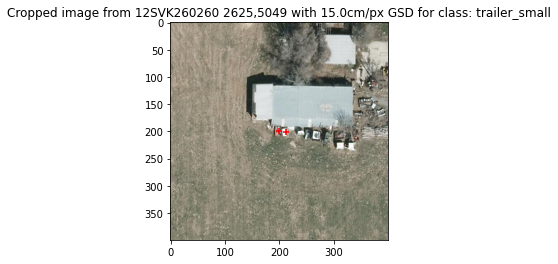

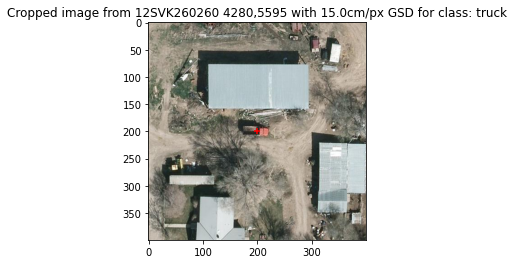

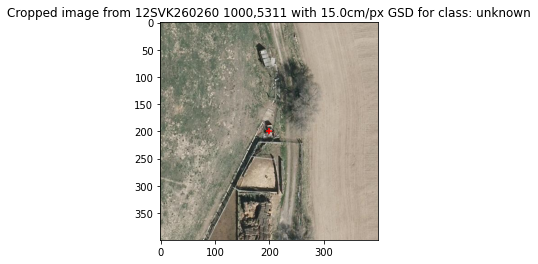

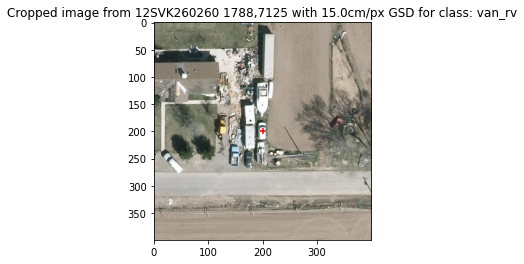

********************************Target Image : 20.0cm/px, cropped images with Annotations******************************************


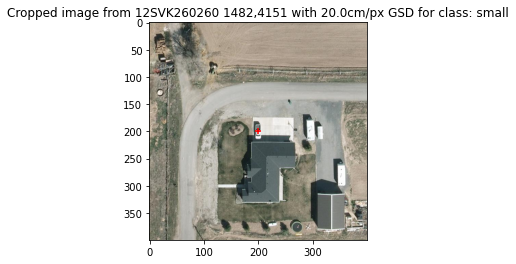

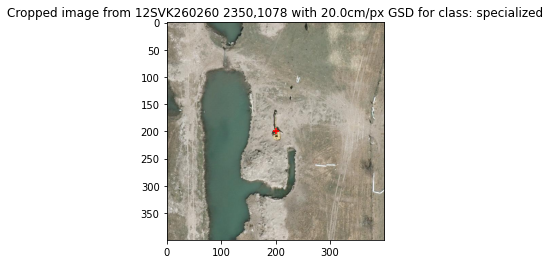

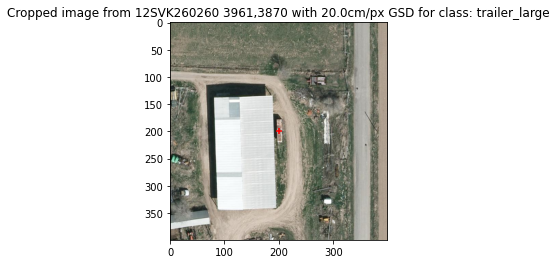

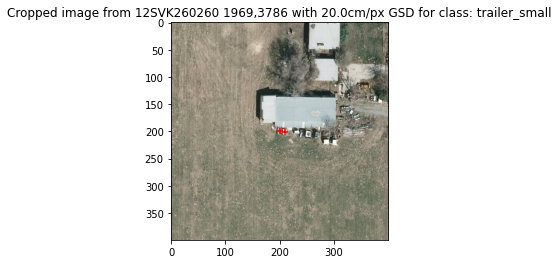

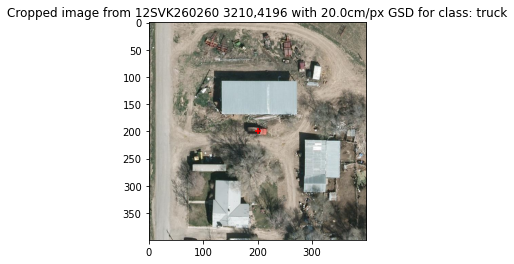

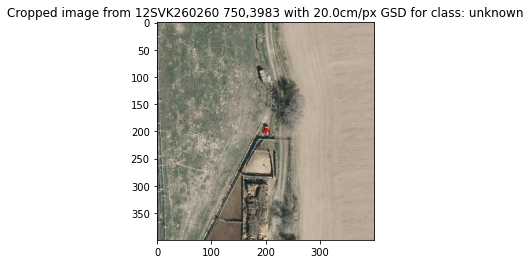

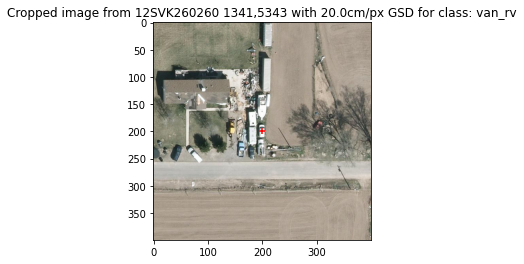

********************************Target Image : 30.0cm/px, cropped images with Annotations******************************************


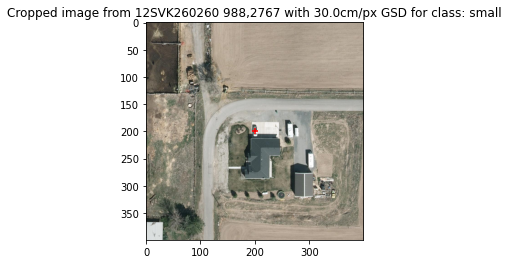

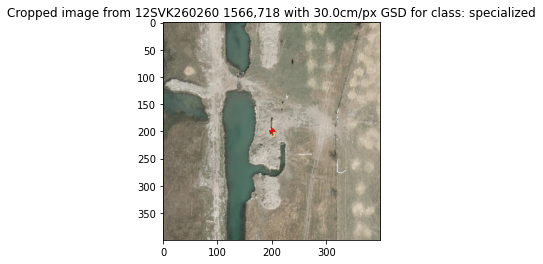

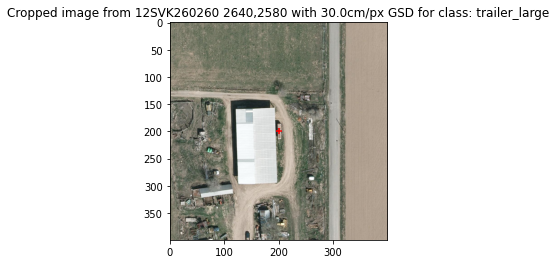

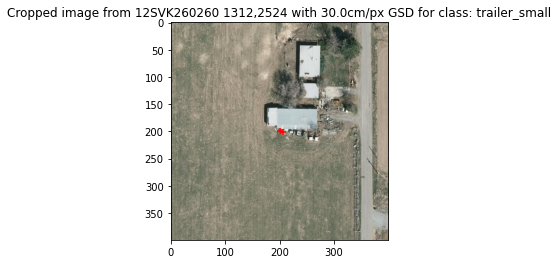

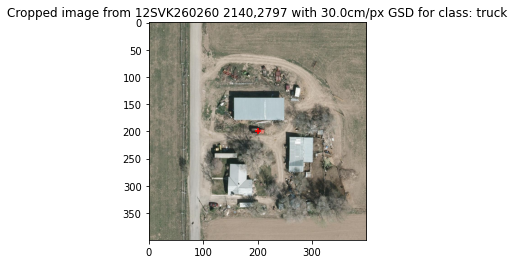

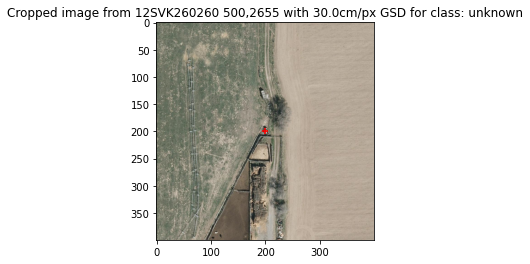

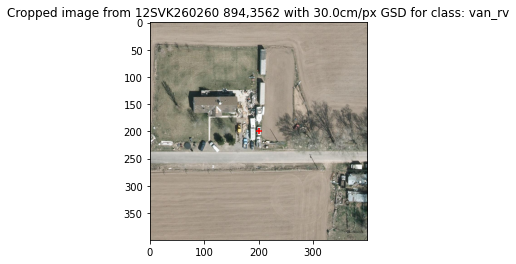

********************************Source Image : 12.5cm/px, cropped images with Annotations******************************************


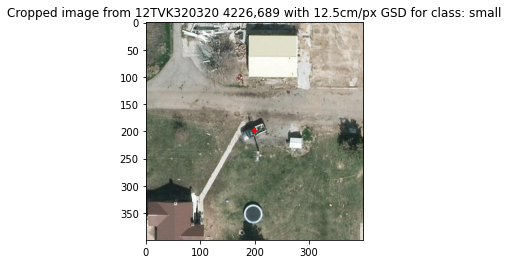

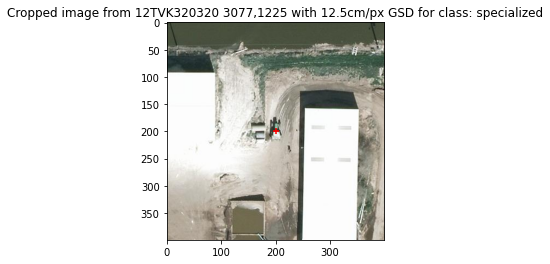

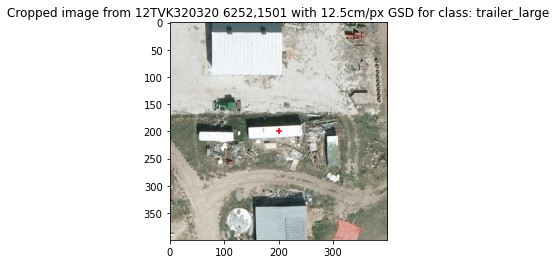

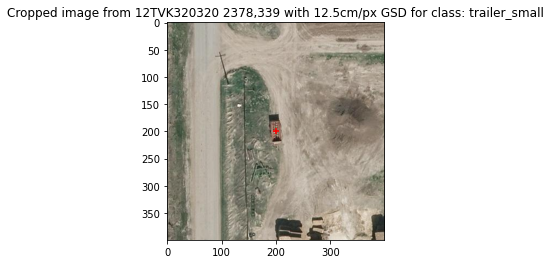

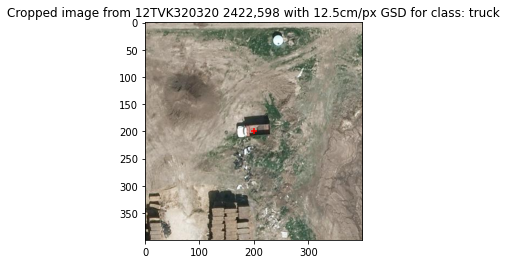

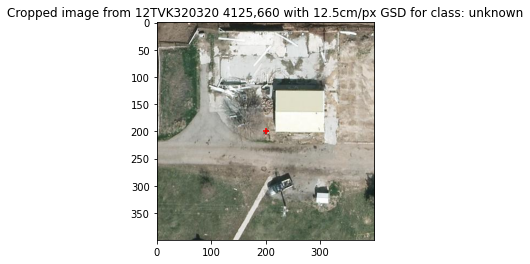

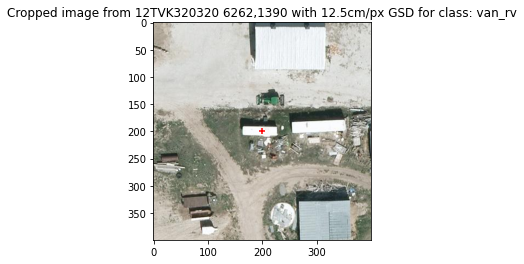

********************************Target Image : 15.0cm/px, cropped images with Annotations******************************************


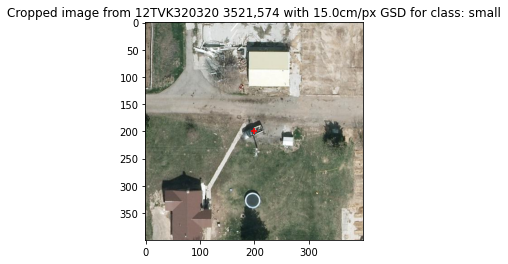

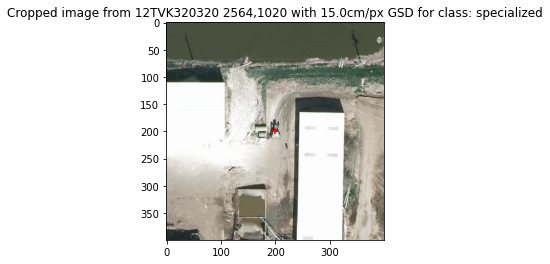

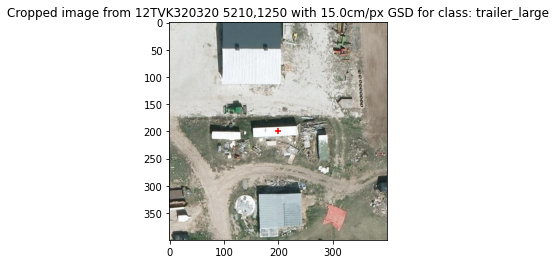

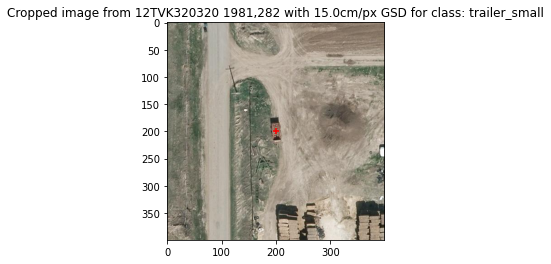

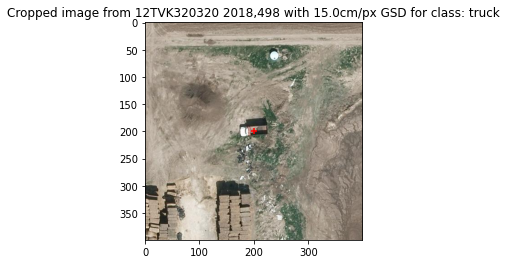

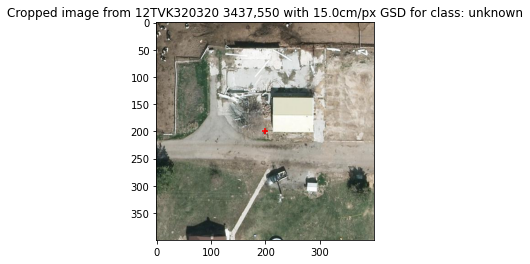

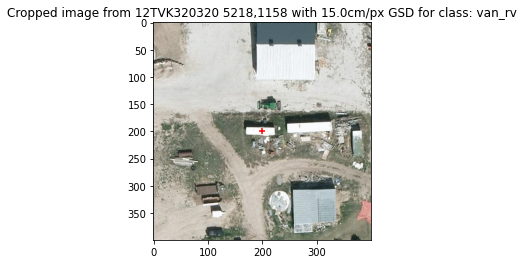

********************************Target Image : 20.0cm/px, cropped images with Annotations******************************************


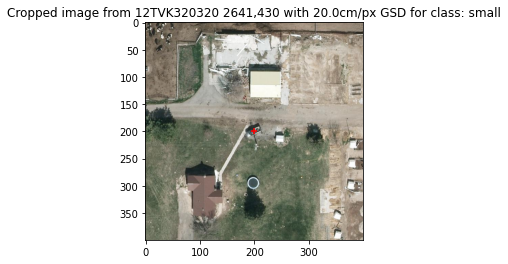

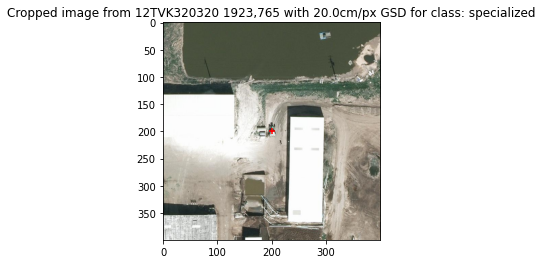

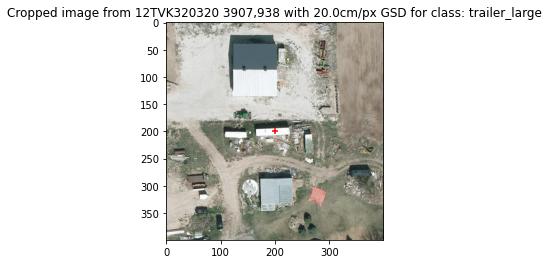

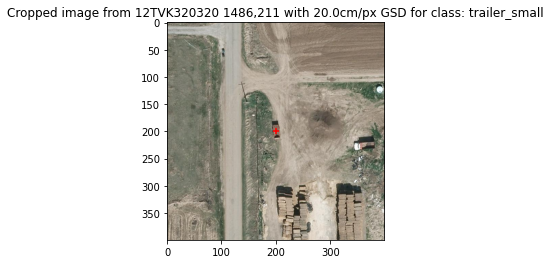

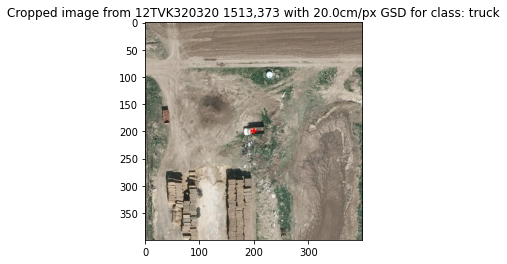

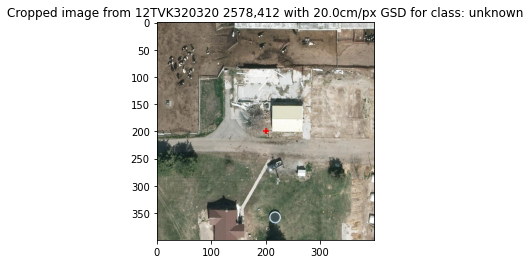

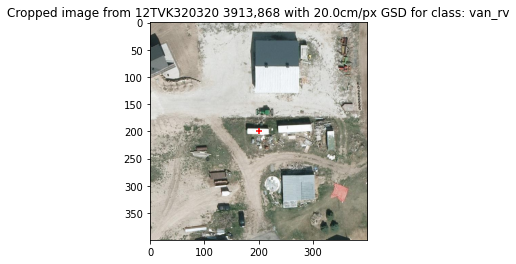

********************************Target Image : 30.0cm/px, cropped images with Annotations******************************************


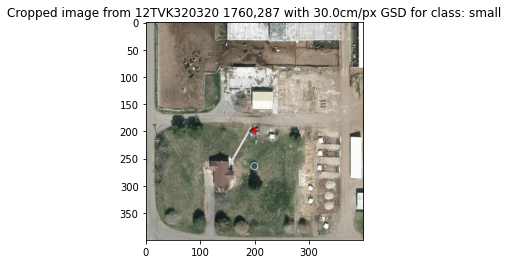

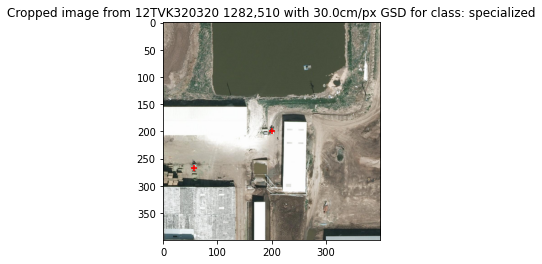

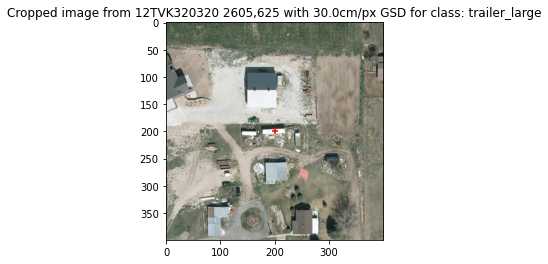

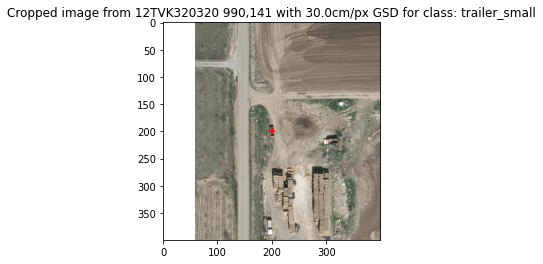

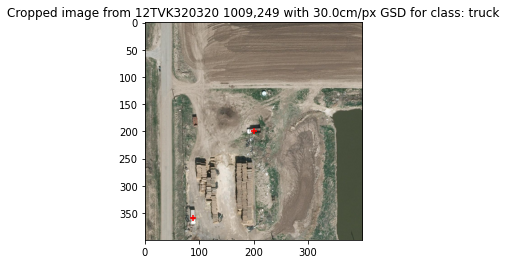

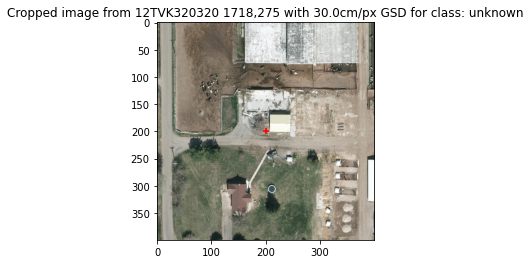

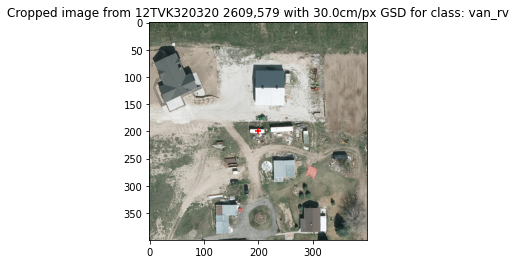

********************************Source Image : 12.5cm/px, cropped images with Annotations******************************************


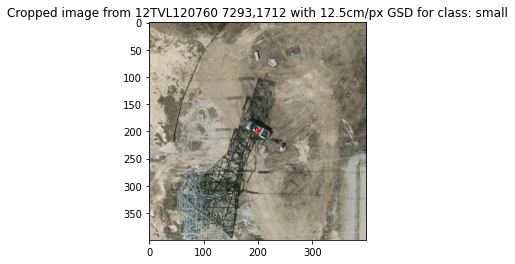

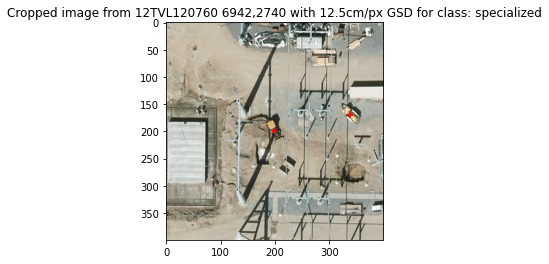

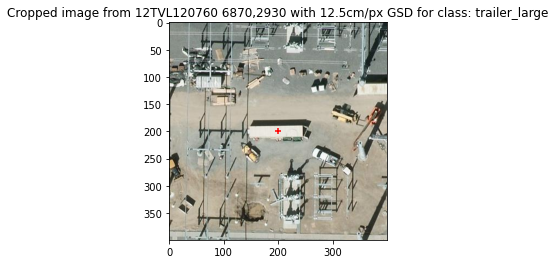

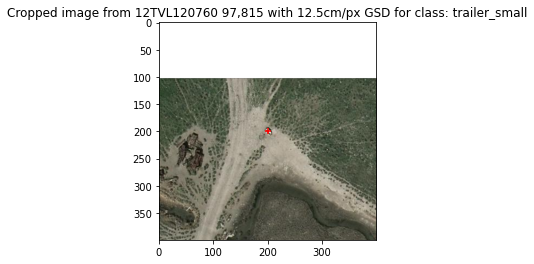

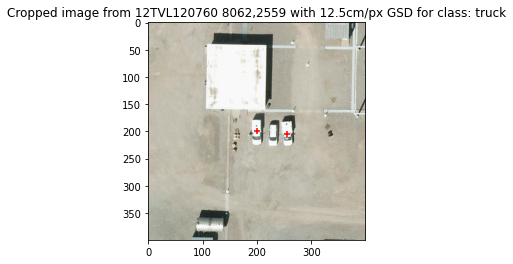

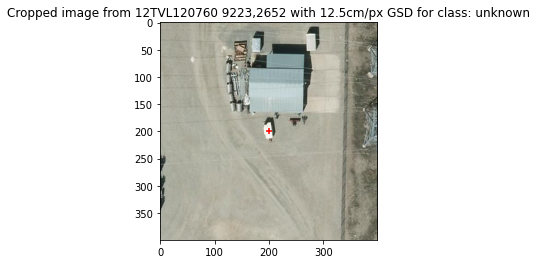

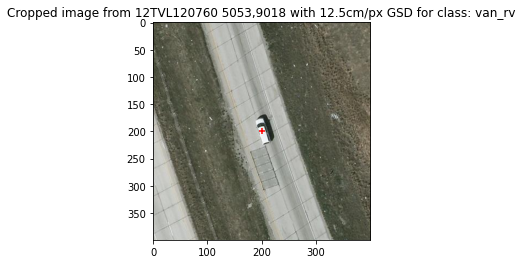

********************************Target Image : 15.0cm/px, cropped images with Annotations******************************************


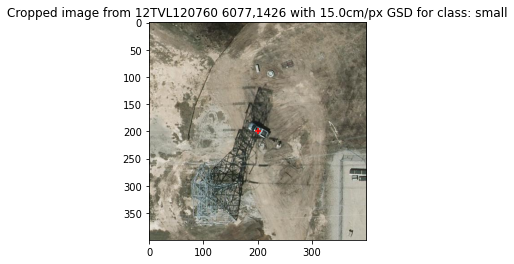

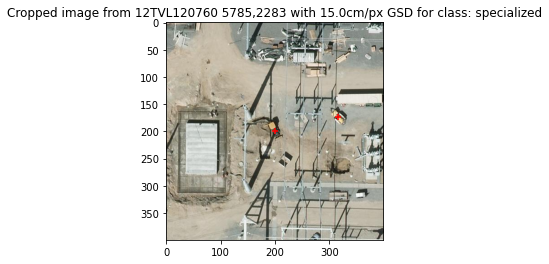

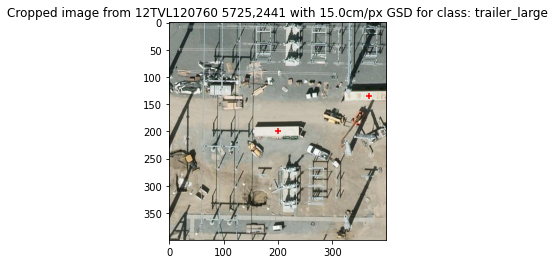

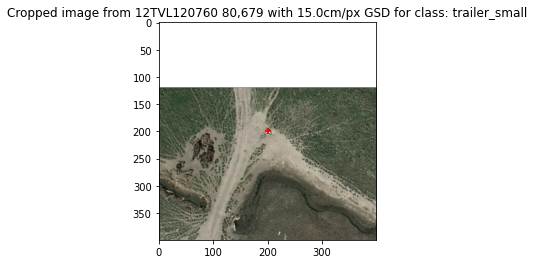

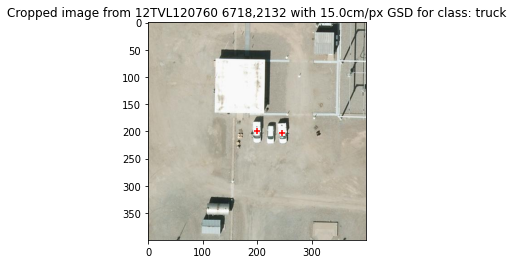

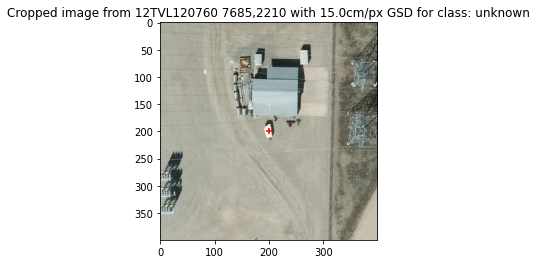

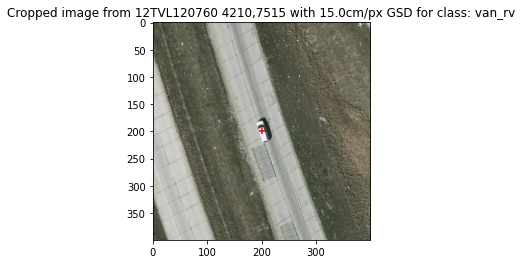

********************************Target Image : 20.0cm/px, cropped images with Annotations******************************************


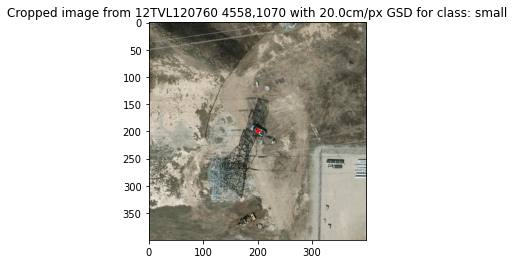

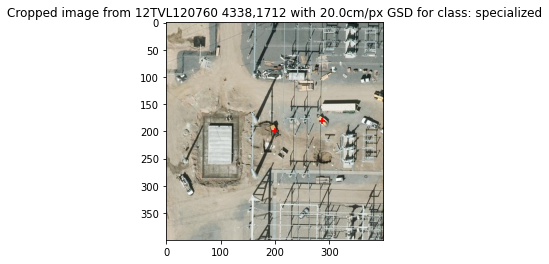

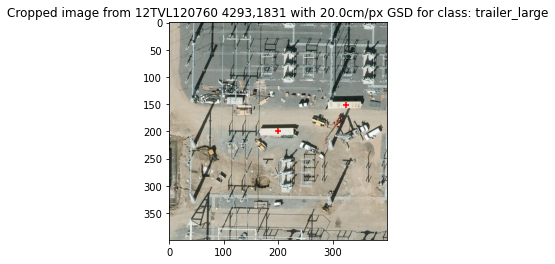

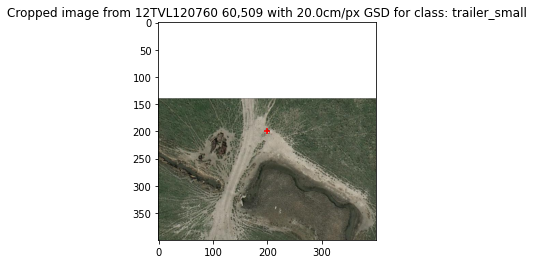

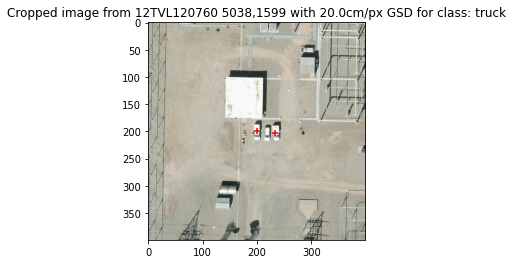

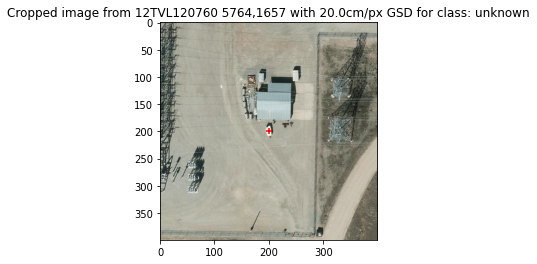

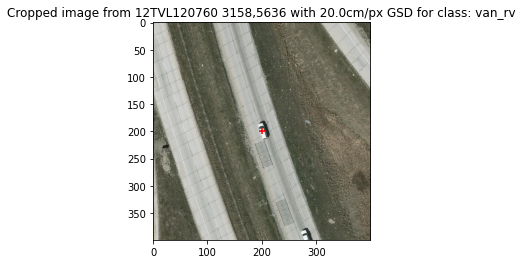

********************************Target Image : 30.0cm/px, cropped images with Annotations******************************************


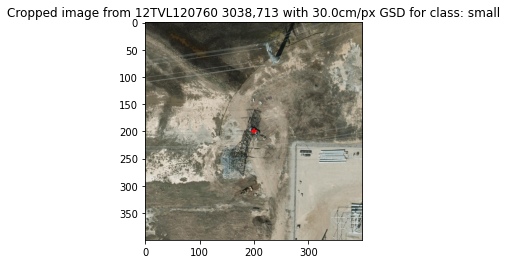

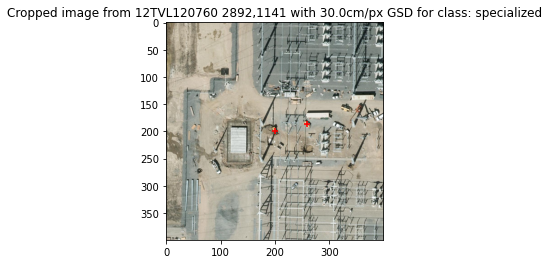

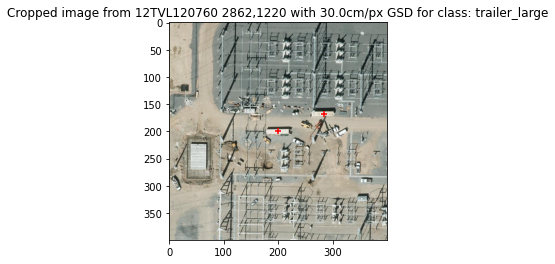

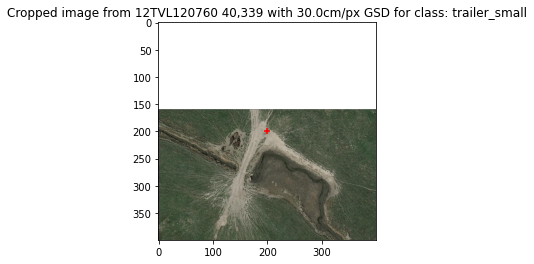

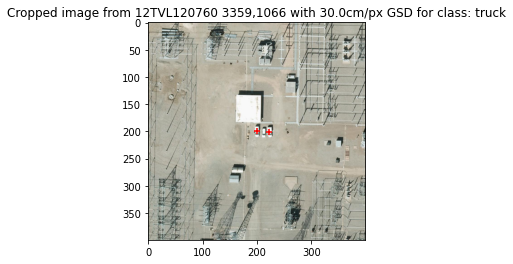

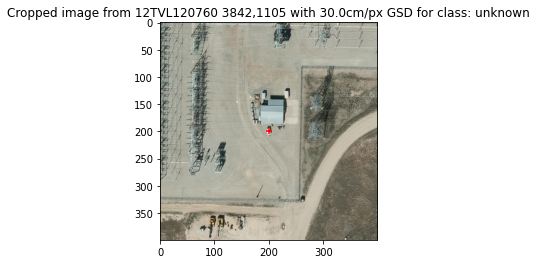

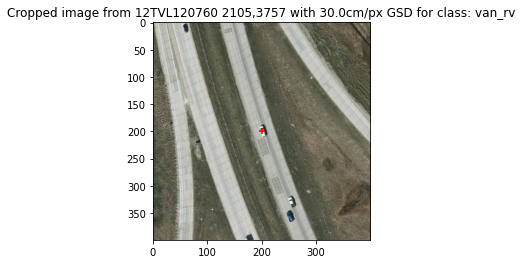

In [65]:
root = os.path.join(r'C:\Users\exx\Documents\lab\LINZ\Final\test')
root = os.path.join(r'C:\Users\exx\Documents\lab\AGRC(Utah)')
sources = [os.path.join(root,"01 HRO 2012 (12.5cm)","12SVK260260"), 
os.path.join(root,"01 HRO 2012 (12.5cm)","12TVK320320"),os.path.join(root, "01 HRO 2012 (12.5cm)","12TVL120760")]

resampledsources_15 = [os.path.join(root,"15cm","12SVK260260"), 
os.path.join(root,"15cm","12TVK320320"), os.path.join(root,"15cm","12TVL120760")]

resampledsources_20 = [os.path.join(root,"20cm","12SVK260260"), 
os.path.join(root,"20cm","12TVK320320"), os.path.join(root,"20cm","12TVL120760")]

resampledsources_30 = [os.path.join(root,"30cm","12SVK260260"), 
os.path.join(root,"30cm","12TVK320320"), os.path.join(root,"30cm","12TVL120760")]

annotations_files = ["12SVK260260_annotations.json","12TVK320320_annotations.json","12TVL120760_annotations.json"]
imagefiles = ["12SVK260260.png","12TVK320320.png","12TVL120760.png"]

for imgfile, annfile, source, resamplesource_15, resamplesource_20,resamplesource_30 in zip(imagefiles,annotations_files,sources, resampledsources_15, resampledsources_20, resampledsources_30 ):
    resampled_annotations_files = [ Path(os.getcwd()).parent.joinpath(resamplesource_15,annfile), 
            Path(os.getcwd()).parent.joinpath(resamplesource_20,annfile) , Path(os.getcwd()).parent.joinpath(resamplesource_30,annfile)]
    resampled_imagefiles = [ Path(os.getcwd()).parent.joinpath(resamplesource_15,imgfile),
            Path(os.getcwd()).parent.joinpath(resamplesource_20,imgfile), Path(os.getcwd()).parent.joinpath(resamplesource_30,imgfile)]

    source_annotations_file = Path(os.getcwd()).parent.joinpath(source, annfile)
    source_imagefile = Path(os.getcwd()).parent.joinpath(source,imgfile)
    
    print("********************************Source Image : 12.5cm/px, cropped images with Annotations******************************************")
    plot_image_annotation_validation(source_annotations_file, source_imagefile, "12.5cm/px")
    
    print("********************************Target Image : 15.0cm/px, cropped images with Annotations******************************************")
    plot_image_annotation_validation(resampled_annotations_files[0], resampled_imagefiles[0], "15.0cm/px")
    
    print("********************************Target Image : 20.0cm/px, cropped images with Annotations******************************************")
    plot_image_annotation_validation(resampled_annotations_files[1], resampled_imagefiles[1], "20.0cm/px")
    
    print("********************************Target Image : 30.0cm/px, cropped images with Annotations******************************************")
    plot_image_annotation_validation(resampled_annotations_files[2], resampled_imagefiles[2], "30.0cm/px")